# Retirement Planner

---

## Environment Setup

In [1]:
# Import libraries and dependencies
import numpy as np
import pandas as pd
import os
from datetime import datetime, timedelta
import matplotlib.pyplot as plt
import alpaca_trade_api as tradeapi
%matplotlib inline

In [2]:
# Set the random seed for resutls reproducibility (for testing purposes only)
np.random.seed(42)

---

## Portfolio Planner

In this activity, you will use the Alpaca API to grab historical data for a `60/40` portfolio using `SPY` to represent the stock portion and `AGG` to represent the bonds.

In [3]:
# Load .env enviroment variables
from dotenv import load_dotenv
load_dotenv()

# Set Alpaca API key and secret
alpaca_api_key = os.getenv("ALPACA_API_KEY")
alpaca_secret_key = os.getenv("ALPACA_SECRET_KEY")

# Create the Alpaca API object
api = tradeapi.REST(
    alpaca_api_key,
    alpaca_secret_key,
    api_version="v2")

# Data Collection

In this step, you will need to use the Alpaca api to fetch closing prices for the `SPY` and `AGG` tickers. Save the results as a pandas DataFrame

In [4]:
# Subset your tickers, then pull returns data:
# Set the ticker
ticker = ["SPY", "AGG"]

# Set timeframe to '1D'
timeframe = "1D"

# Set start and end datetimes of 1 year, between now and 365 days ago.
start_date = pd.Timestamp('2019-01-01', tz='America/New_York').isoformat()
end_date = pd.Timestamp('2019-12-31', tz='America/New_York').isoformat()

# Get 1 year's worth of historical data for SPY and AGG
df = api.get_barset(
    ticker,
    timeframe,
    limit=None,
    start=start_date,
    end=end_date,
    after=None,
    until=None,
).df

# Drop unnecessary columns
df = df.drop(
    columns=['open', 'high', 'low', 'volume'],
    level=1
)

In [5]:
# Display sample data
df.head()

,AGG,SPY
,close,close
time,,
2019-01-02 00:00:00-05:00,106.585,249.89
2019-01-03 00:00:00-05:00,107.020,244.46
2019-01-04 00:00:00-05:00,106.695,252.41
2019-01-07 00:00:00-05:00,106.470,254.40
2019-01-08 00:00:00-05:00,106.420,256.65


---

## Monte Carlo Simulation

In this step, you will run Monte Carlo Simulations for your portfolio to model portfolio performance at different retirement ages. 

Complete the following steps:

1. Calculate the daily returns for the SPY and AGG closing prices.

2. Calculate volatility for both the SPY and AGG closing prices.

3. Find the last day's closing price for both stocks and save those as variables

4. Run a Monte Carlo Simulation of at least `100` iterations and generate at least `30` years of closing prices

**Hint:** There are `252` trading days per year, so the number of records to generate for each Monte Carlo run will be `252 days * 30 years`.

In [6]:
# Calculate the daily roi for the stocks
daily_returns = df.pct_change()
# Display sample data
daily_returns.head()

,AGG,SPY
,close,close
time,,
2019-01-02 00:00:00-05:00,NaN,NaN
2019-01-03 00:00:00-05:00,0.004081,-0.021730
2019-01-04 00:00:00-05:00,-0.003037,0.032521
2019-01-07 00:00:00-05:00,-0.002109,0.007884
2019-01-08 00:00:00-05:00,-0.000470,0.008844


In [7]:
# Compute daily volatility
std_dev_daily_return_AGG = daily_returns.std()["AGG"]["close"]
std_dev_daily_return_SPY = daily_returns.std()["SPY"]["close"]

In [8]:
# Computing meean return
avg_daily_return_AGG = daily_returns.mean()["AGG"]["close"]
avg_daily_return_SPY = daily_returns.mean()["SPY"]["close"]


In [9]:
# Save the last day's closing price
AGG_last_price = df["AGG"]["close"][-1]
SPY_last_price = df["SPY"]["close"][-1]

In [10]:
# Setup the Monte Carlo Parameters
number_simulations = 500
number_records = 252 * 30
monte_carlo = pd.DataFrame()
simulated_prices_df = pd.DataFrame()
portfolio_cumulative_returns = pd.DataFrame()

In [14]:
# Run the Monte Carlo Simulation
for n in range(number_simulations):
    #in our list of simulated prices we are going to start off with the last real price
    simulated_AGG_prices = [AGG_last_price]
    simulated_SPY_prices = [SPY_last_price]
    # for each simulation we are going to create 30 years worth of trading day closes
    for i in range(number_records):
        # calculating the simulated price by taking the last price in the list and multiplying from a random return chosen from the normalized distribution of returns
        simulated_AGG_price = simulated_AGG_prices[-1] * (1 + np.random.normal(avg_daily_return_AGG, std_dev_daily_return_AGG))
        simulated_SPY_price = simulated_SPY_prices[-1] * (1 + np.random.normal(avg_daily_return_SPY, std_dev_daily_return_AGG))

        simulated_AGG_prices.append(simulated_AGG_price)
        simulated_SPY_prices.append(simulated_SPY_price)
    simulated_prices_df['AGG'] = simulated_AGG_prices
    simulated_prices_df['SPY'] = simulated_SPY_price
    # Calculating the daily returns of the simulated prices
    simulated_daily_returns = simulated_prices_df.pct_change()
    # Set the weights to the price
    weights = [0.4,0.6]
    # Apply weights to daily simulate returns
    portfolio_daily_returns = simulated_daily_returns.dot(weights)
    # Gettting the cumulative returns on the portfolio
    portfolio_cumulative_returns[n] = (1 + portfolio_daily_returns.fillna(0)).cumprod()

In [15]:
# Check that the simulation ran successfully
portfolio_cumulative_returns.tail()

,0,1,2,3,4,5,6,7,8,9,...,490,491,492,493,494,495,496,497,498,499
7556,2.079413,1.795527,2.066653,2.001169,1.977972,1.901284,2.099034,1.796973,1.918160,2.126741,...,1.824676,1.862627,1.880754,1.636143,1.913245,1.999938,1.835980,1.887942,1.914318,2.038003
7557,2.080343,1.795073,2.069938,1.999639,1.977799,1.904511,2.096708,1.798542,1.916353,2.127870,...,1.825845,1.862904,1.879641,1.635993,1.913592,1.998719,1.836890,1.886061,1.913879,2.040946
7558,2.078075,1.796768,2.069312,2.000105,1.979381,1.905438,2.094668,1.797782,1.916243,2.128718,...,1.825810,1.864956,1.879161,1.636769,1.913106,1.998557,1.834337,1.887921,1.915268,2.040867
7559,2.077179,1.797996,2.070409,1.999409,1.977708,1.907467,2.096413,1.800016,1.918817,2.126639,...,1.824322,1.863909,1.879547,1.635918,1.909774,1.999049,1.836650,1.888540,1.915556,2.041691
7560,2.076550,1.800584,2.073624,1.998097,1.979034,1.911578,2.094665,1.800051,1.919696,2.128144,...,1.824762,1.864118,1.879152,1.635411,1.910821,1.999010,1.834162,1.886981,1.917542,2.043341


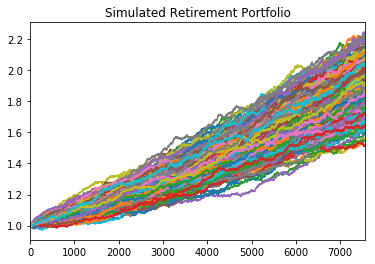

In [16]:
# Visualize the Simulation
portfolio_cumulative_returns.plot(legend=None, title="Simulated Retirement Portfolio")

In [17]:
# Select the last row for the cumulative returns (cumulative returns at 20 years)
ending_cumulative_returns = portfolio_cumulative_returns.iloc[-1, :]
ending_cumulative_returns.head()

0    2.076550
1    1.800584
2    2.073624
3    1.998097
4    1.979034
Name: 7560, dtype: float64

In [18]:
# Display the 90% confidence interval for the ending returns
confidence_interval = ending_cumulative_returns.quantile(q=[0.05, 0.95])
confidence_interval

0.05    1.663623
0.95    2.113619
Name: 7560, dtype: float64

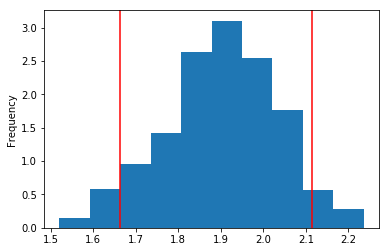

In [19]:
# Visualize the distribution of the ending returns
plt.figure()
ending_cumulative_returns.plot(kind="hist", density=True, bins=10)
plt.axvline(confidence_interval.iloc[0], color="r")
plt.axvline(confidence_interval.iloc[1], color="r")

---

## Retirement Analysis

In this section, you will use the monte carlo model to answer the following retirement planning questions:

1. What are the expected cumulative returns at `30` years for the `10th`, `50th`, and `90th` percentiles?

2. Given an initial investment of `$20,000`, what is the expected return in dollars at the `10th`, `50th`, and `90th` percentiles?

3. Given the current projected annual income from the Plaid analysis, will a `4%` withdrawal rate meet or exceed that value at the `10th` percentile? Note: This is basically determining if retirement income is equivalent to current income.

4. How would a `50%` increase in the initial investment amount affect the `4%` retirement withdrawal? In other words, what happens if the initial investment had been bigger?

### What are the expected cumulative returns at 30 years for the 10th, 50th, and 90th percentiles?

In [20]:
# Compute cumulative returns
confidence_interval_10 = ending_cumulative_returns.quantile(q=[0.45, 0.55])
confidence_interval_50 = ending_cumulative_returns.quantile(q=[0.25, 0.75])
confidence_interval_90 = ending_cumulative_returns.quantile(q=[0.05, 0.95])

### Given an initial investment of `$20,000`, what is the expected portfolio return in dollars at the 10th, 50th, and 90th percentiles?

In [21]:
# Set initial investment
initial_investment = 20000
# Compute expected portfolio return
investment_pnl_lower_bound_10 = initial_investment + (initial_investment * confidence_interval_10.iloc[0])
investment_pnl_upper_bound_10 = initial_investment + (initial_investment * confidence_interval_10.iloc[1])
investment_pnl_lower_bound_50 = initial_investment + (initial_investment * confidence_interval_50.iloc[0])
investment_pnl_upper_bound_50 = initial_investment + (initial_investment * confidence_interval_50.iloc[1])
investment_pnl_lower_bound_90 = initial_investment + (initial_investment * confidence_interval_90.iloc[0])
investment_pnl_upper_bound_90 = initial_investment + (initial_investment * confidence_interval_90.iloc[1])
print(f"There is a 10% chance that an initial investment of $20,000 in the portfolio"
      f" over the next 252*30 trading days will end within in the range of"
      f" ${investment_pnl_lower_bound_10} and ${investment_pnl_upper_bound_10}")
print(f"There is a 50% chance that an initial investment of $20,000 in the portfolio"
      f" over the next 252*30 trading days will end within in the range of"
      f" ${investment_pnl_lower_bound_50} and ${investment_pnl_upper_bound_50}")
print(f"There is a 90% chance that an initial investment of $20,000 in the portfolio"
      f" over the next 252*30 trading days will end within in the range of"
      f" ${investment_pnl_lower_bound_90} and ${investment_pnl_upper_bound_90}")

There is a 10% chance that an initial investment of $20,000 in the portfolio over the next 252*30 trading days will end within in the range of $57918.73390920435 and $58458.407388316045
There is a 50% chance that an initial investment of $20,000 in the portfolio over the next 252*30 trading days will end within in the range of $56427.769537711894 and $59928.66398751883
There is a 90% chance that an initial investment of $20,000 in the portfolio over the next 252*30 trading days will end within in the range of $53272.451820927985 and $62272.370116164086


### Given the current projected annual income from the Plaid analysis, will a 4% withdraw rate from the retirement portfolio meet or exceed that value at the 10th percentile?

Note: This is effectively saying that 90% of the expected returns will be greater than the return at the 10th percentile, so this can help measure the uncertainty about having enough funds at retirement

In [22]:
# Set Plaid's projected income
projected_yearly_income = 6085
# Calculate the 4% withdrawal for the ending return as retirement income
withdrawal_lower = investment_pnl_lower_bound_90 * 0.04
withdrawal_upper = investment_pnl_upper_bound_90 * 0.04
# Determine if the retirement income meets or exceeds the current projected income
if withdrawal_upper > projected_yearly_income:
    print("A 4% withdrawal will exceed the projected annual income")
elif withdrawal_upper == projected_yearly_income:
    print("A 4% withdrawal will meet the projected annual income")
else:
    print("A 4% withdrawal does not meet the projected annual income")

A 4% withdrawal does not meet the projected annual income


### How would a 50% increase in the initial investment amount affect the 4% retirement withdrawal?

In [23]:
# Re-calculate the retirement income with a 50% increase in the initial investment amount
# Set initial investment
initial_investment_increased = 20000 * 1.5
# Compute expected portfolio return
investment_pnl_lower_bound_10_increased = initial_investment_increased + (initial_investment_increased * confidence_interval_10.iloc[0])
investment_pnl_upper_bound_10_increased = initial_investment_increased + (initial_investment_increased * confidence_interval_10.iloc[1])
investment_pnl_lower_bound_50_increased = initial_investment_increased + (initial_investment_increased * confidence_interval_50.iloc[0])
investment_pnl_upper_bound_50_increased = initial_investment_increased + (initial_investment_increased * confidence_interval_50.iloc[1])
investment_pnl_lower_bound_90_increased = initial_investment_increased + (initial_investment_increased * confidence_interval_90.iloc[0])
investment_pnl_upper_bound_90_increased = initial_investment_increased + (initial_investment_increased * confidence_interval_90.iloc[1])

withdrawal_lower = investment_pnl_lower_bound_90_increased * 0.04
withdrawal_upper = investment_pnl_upper_bound_90_increased * 0.04
# Determine if the retirement income meets or exceeds the current projected income
if withdrawal_upper > projected_yearly_income:
    print("A 4% withdrawal will exceed the projected annual income")
elif withdrawal_upper == projected_yearly_income:
    print("A 4% withdrawal will meet the projected annual income")
else:
    print("A 4% withdrawal does not meet the projected annual income")

A 4% withdrawal does not meet the projected annual income


### Optional Challenge

Use the Monte Carlo data and calculate the cumulative returns at the `5%`, `50%`, and `95%` quartiles and plot this data as a line chart to see how the cumulative returns change over the life of the investment.

In this section, you need to calculate and plot the cumulative returns for the median and `90%` confidence intervals. This plot shows the expected cumulative returns for any given day between the first day and the last day of investment. 

In [24]:
# Compute projected returns
# Display sample data
df = portfolio_cumulative_returns.transpose().quantile(q=[0.05]).transpose().join([
    portfolio_cumulative_returns.transpose().quantile(q=[0.95]).transpose(),
    portfolio_cumulative_returns.transpose().quantile(q=[0.5]).transpose()
])
df.head()

,0.05,0.95,0.5
0,1.000000,1.000000,1.000000
1,0.998700,1.001514,1.000114
2,0.998282,1.002127,1.000176
3,0.997949,1.002589,1.000181
4,0.997596,1.002999,1.000155


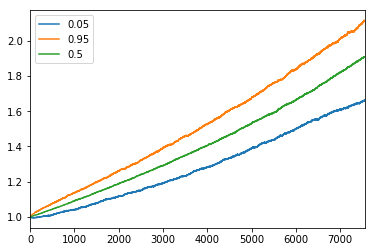

In [25]:
# Plot the cumulative returns over time
df.plot()

In [ ]:
# Compute portfolio performance over time

# Plot projected performance over time
